In [1]:
import os 
os.environ["HOME"] = "/home/nas4_user/jinhochoi"
import sys
import torch
import numpy as np
import plotly.graph_objects as go
sys.path.append('../../../')
from src.conceptscope.conceptscope import ConceptScope
from src.utils.image_dataset_loader import ImageDatasetLoader
from src.utils.utils import load_class_names
from src.experiments.bias_discovery.utils import get_class_sae_activation, plot_concepts,plot_high_low_images, plot_ref_images

import json

/home/nas4_user/jinhochoi/anaconda3/envs/py311/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/nas4_user/jinhochoi/anaconda3/envs/py311/lib/python3.11/site-packages/torchvision/datapoints/__init__.py:12: UserWarning: The torchvision.datapoints and torchvision.transforms.v2 namespaces are still Beta. While we do not expect major breaking changes, some APIs may still change according to user feedback. Please submit any feedback you may have in this issue: https://github.com/pytorch/vision/issues/6753, and you can also check out https://github.com/pytorch/vision/issues/7319 to learn more about the APIs that we suspect might involve future changes. You can silence this warning by calling torchvision.disable_beta_transforms_warning().
  warnings.warn(_BETA_TRANSFORMS_WARNING)
/home/nas4_user/jinhochoi/

In [2]:

save_root = '../../../out'
data_root = '../../../data'
dir_name  = 'dataset_analysis'
bacbkbone = 'openai/clip-vit-large-patch14'
clip_model = 'openai/clip-vit-large-patch14'
checkpoint_name = 'openai_l14_32K_base'
sae_path = f'../../../out/checkpoints/{checkpoint_name}/clip-vit-large-patch14_-2_resid_32768.pt'
num_samples = 256
device = 'cuda:6' if torch.cuda.is_available() else 'cpu'

conceptscope = ConceptScope(
    save_root=save_root,
    dir_name=dir_name,
    data_root=data_root,
    backbone=bacbkbone,
    clip_model_name=clip_model,          
    sae_path=sae_path,
    num_samples_for_alignment=num_samples,
    device=device
)

In [3]:
dataset_name = 'imagenet'
split = 'val'
train_split = 'train'

# dataset_name = 'nico_75'
# split = 'test'
# train_split = 'train'

# dataset_name = 'waterbird'
# split = 'test'
# train_split = 'train'

test_dataset = ImageDatasetLoader.load_dataset(dataset_name=dataset_name, split=split, root=data_root)
train_dataset = ImageDatasetLoader.load_dataset(dataset_name=dataset_name, split=train_split, root=data_root)
class_names = load_class_names(data_root, dataset_name, test_dataset)

test_labels = np.array(test_dataset['label'])
train_labels = np.array(train_dataset['label'])

concept_dict = conceptscope.run(dataset_name, train_split, target_threshold=1.0)




Running ConceptScope for dataset: imagenet, split: train
Using SAE model checkpoint: openai_l14_32K_base
Load dataset and extract SAE activations
Categorizing concepts based on alignment scores


Categorizing concepts: 100%|██████████| 1000/1000 [00:00<00:00, 15091.71it/s]


In [4]:
selected_class = 32
class_name = class_names[selected_class]
test_class_indices = np.where(test_labels == selected_class)[0]
train_class_indices = np.where(train_labels == selected_class)[0]
if isinstance(class_name, list):
    class_name = class_name[0]
print(class_name)
data = plot_concepts(concept_dict, selected_class, target_threshold=1.0, bias_sigma=1.0, max_concepts=20, save_fig=True)

test_class_activation = get_class_sae_activation(dataset_name, split, selected_class, checkpoint_name, save_root=save_root)
train_class_activation = get_class_sae_activation(dataset_name, 'train', selected_class, checkpoint_name, save_root=save_root)

tailed frog


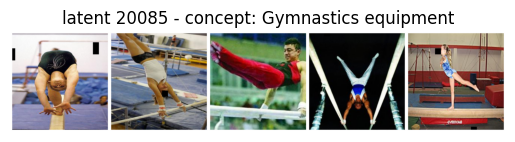

train


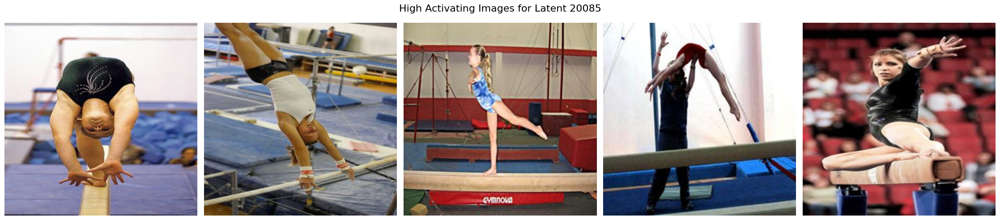

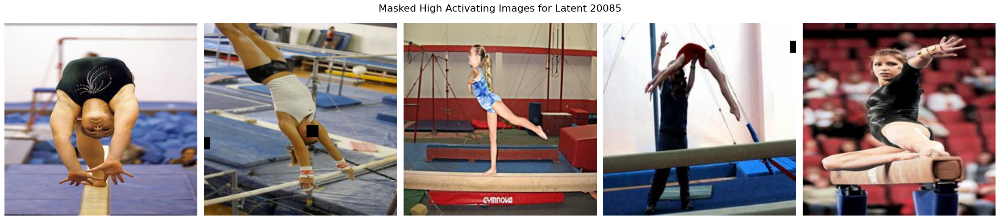

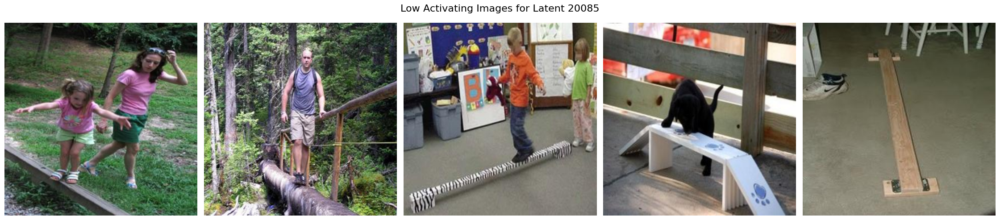

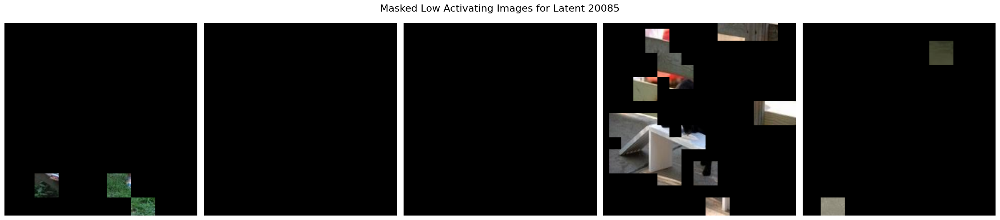

test


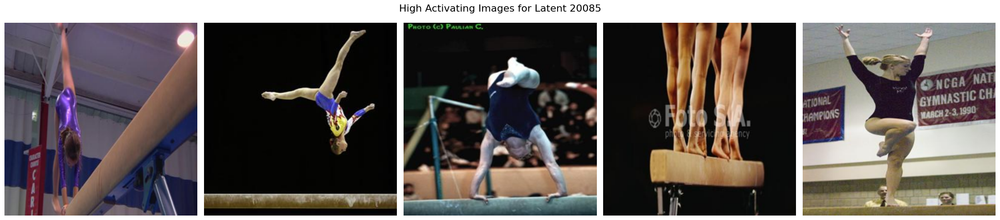

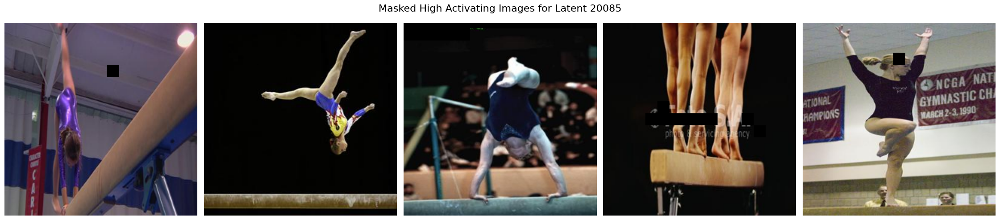

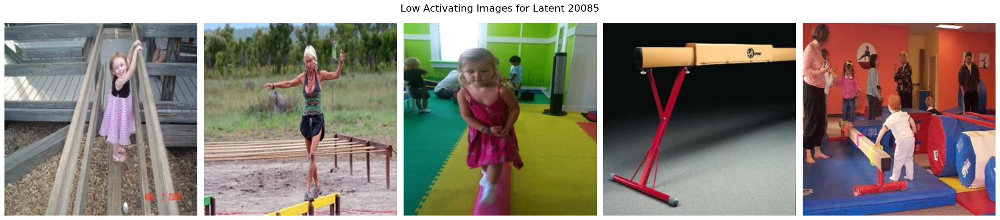

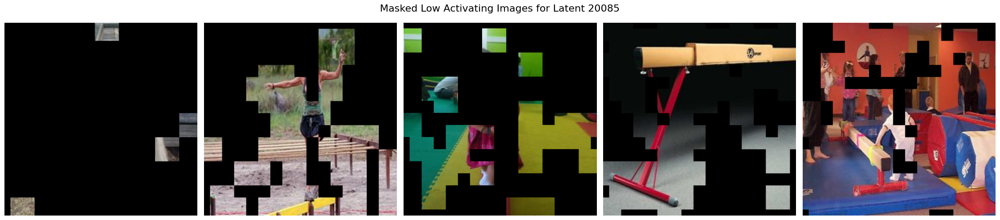

In [ ]:
selected_latent = 20085

concept_name = conceptscope.concept_dict[str(selected_latent)]
plot_ref_images(checkpoint_name, selected_latent, concept_name=concept_name, save_root=save_root, show_title=True)

print('train')
plot_high_low_images(
    selected_latent,
    train_class_indices,
    train_class_activation,
    train_dataset,
    conceptscope.sae,
    conceptscope.vit,
    conceptscope.cfg,
    top_k=5,
    blend_rate_high=0.0,
    blend_rate_low=0.0,
    gamma=0.001,
    resize_size=256,
    percentile=0,
    device=device,
)

print('test')
plot_high_low_images(
    selected_latent,
    test_class_indices,
    test_class_activation,
    test_dataset,
    conceptscope.sae,
    conceptscope.vit,
    conceptscope.cfg,
    top_k=5,
    blend_rate_high=0.0,
    blend_rate_low=0.0,
    gamma=0.001,
    resize_size=256,
    percentile=0,
    device=device,
)





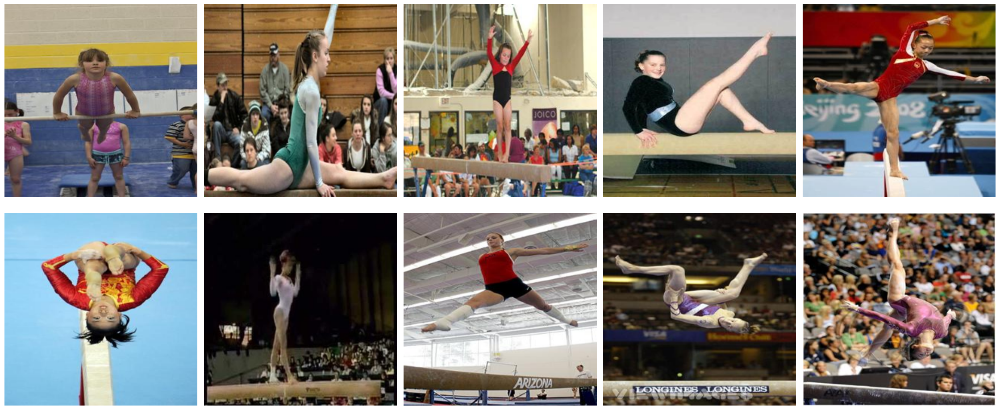

In [5]:
from src.utils.utils import apply_sae_mask_to_input, get_sae_mask, plot_images
from PIL import Image
from src.experiments.bias_discovery.utils import plot_ref_images

resize_size = 256
num_examples = 10
blend_rate = 0.1
gamma = 0.001
sampled_indices = np.random.choice(test_class_indices, num_examples, replace=False)

images = []
for idx in sampled_indices:
    image = test_dataset[int(idx)]["image"]
    if isinstance(image, str):
        image = Image.open(image)
    images.append(image.resize((resize_size, resize_size)))

fig = plot_images(images)


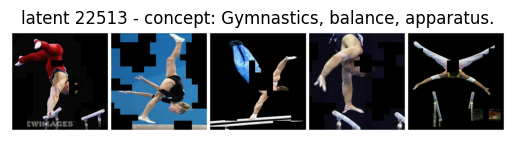

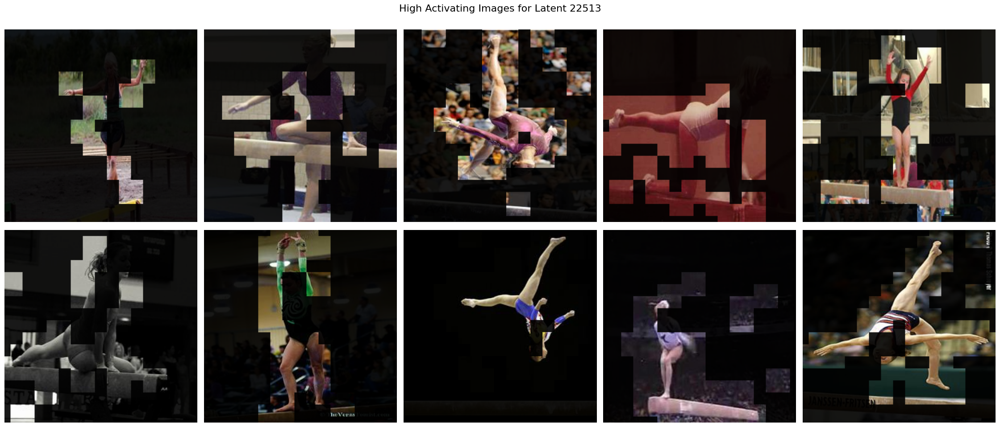

In [25]:
latent_idx = data['latent_idx'][3]

concept_name = conceptscope.concept_dict[str(latent_idx)]

masks = get_sae_mask(images, conceptscope.sae, conceptscope.vit, conceptscope.cfg, latent_idx, resize_size=resize_size, device=device)

masked_images, _ = apply_sae_mask_to_input(
    images, masks, resize_size=resize_size, blend_rate=blend_rate, gamma=gamma, reverse=False
)

plot_ref_images(checkpoint_name, latent_idx, concept_name=concept_name, save_root=save_root, show_title=True)

_ = plot_images(
    masked_images, resize_size=resize_size, show_plot=True, title=f"High Activating Images for Latent {latent_idx}"
)

In [13]:

from torch.profiler import profile, record_function, ProfilerActivity

latent_idx = data['latent_idx'][3]

concept_name = conceptscope.concept_dict[str(latent_idx)]



with profile(
    activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA],
    record_shapes=True,
    with_flops=True,
    profile_memory=True,
    with_stack=False
) as prof:
    with record_function("get_sae_mask"):
        masks = get_sae_mask(
            images,
            conceptscope.sae,       
            conceptscope.vit,
            conceptscope.cfg,
            latent_idx,
            resize_size=256,
            device=device
        )

print(prof.key_averages().table(sort_by="flops", row_limit=20))

total_flops = sum([e.flops for e in prof.key_averages()])
total_gflops = total_flops / 1e9
print(f"Total GFLOPs: {total_gflops:.2f}")



#masks = get_sae_mask([images[0]], conceptscope.sae, conceptscope.vit, conceptscope.cfg, latent_idx, resize_size=resize_size, device=device)


STAGE:2025-07-29 12:03:47 1205339:1205339 ActivityProfilerController.cpp:311] Completed Stage: Warm Up
STAGE:2025-07-29 12:03:47 1205339:1205339 ActivityProfilerController.cpp:317] Completed Stage: Collection
STAGE:2025-07-29 12:03:47 1205339:1205339 ActivityProfilerController.cpp:321] Completed Stage: Post Processing


-------------------------------------------------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  
                                                   Name    Self CPU %      Self CPU   CPU total %     CPU total  CPU time avg     Self CUDA   Self CUDA %    CUDA total  CUDA time avg       CPU Mem  Self CPU Mem      CUDA Mem  Self CUDA Mem    # of Calls  Total MFLOPs  
-------------------------------------------------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  
                                            aten::addmm         2.47%       7.541ms         3.69%      11.271ms      52.181us      91.554ms        59.56%      91.554ms     423.861us           0 

In [11]:
print(prof.key_averages().table(sort_by="flops", row_limit=20))

total_flops = sum([e.flops for e in prof.key_averages()])
total_gflops = total_flops / 1e9
print(f"Total GFLOPs: {total_gflops:.2f}")


-------------------------------------------------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  
                                                   Name    Self CPU %      Self CPU   CPU total %     CPU total  CPU time avg     Self CUDA   Self CUDA %    CUDA total  CUDA time avg       CPU Mem  Self CPU Mem      CUDA Mem  Self CUDA Mem    # of Calls  Total MFLOPs  
-------------------------------------------------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  
                                            aten::addmm         0.26%       7.418ms         0.74%      20.714ms      95.898us      12.858ms        67.07%      13.021ms      60.282us           0 